# PJM regional load analysis via RNN / LSTM / GRU

 * based on original work by [Sheeza Shabbir](https://github.com/SheezaShabbir/Time-series-Analysis-using-LSTM-RNN-and-GRU/tree/main)
 * Purpose is pedagogical
 * Overall Notebook structure is ETL + Methods + main, mirroring the usual code structure
 * Performance gauge: daily min/max comparisons real vs predicted

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import TensorDataset

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from datetime import datetime
from datetime import date

import plotly.offline as pyo
import plotly.graph_objs as go
from plotly.offline import iplot

import holidays

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [2]:
# this identifies the 
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

cuda


In [3]:
df = pd.read_csv("./data/pjm_power_data/PJME_hourly.csv")
df.head()

,Datetime,PJME_MW
0,2002-12-31 01:00:00,26498.0
1,2002-12-31 02:00:00,25147.0
2,2002-12-31 03:00:00,24574.0
3,2002-12-31 04:00:00,24393.0
4,2002-12-31 05:00:00,24860.0


In [4]:
def plot_dataset(df, title):
    data = []
    value = go.Scatter(
        x=df.index,
        y=df.load,
        mode="lines",
        name="values",
        marker=dict(),
        text=df.index,
        line=dict(color="rgba(0,0,0, 0.3)"),
    )
    data.append(value)
    layout = dict(
        title=title,
        xaxis=dict(
            title="Date",
            ticklen=5,
            zeroline=False
        ),
        yaxis=dict(
            title="Value",
            ticklen=5,
            zeroline=False
        ),
    )
    fig = dict(
        data=data,
        layout=layout
    )
    iplot(fig)

In [5]:
df.set_index(
    ["Datetime"],
    inplace=True
)

In [6]:
df.rename(
    columns={"PJME_MW": "load"},
    inplace=True
)

In [7]:
df.index = pd.to_datetime(df.index)

In [8]:
df.sort_index(inplace=True)

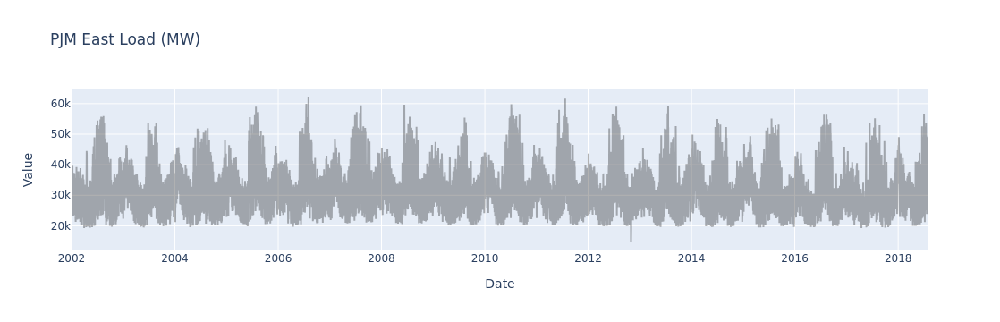

In [9]:
plot_dataset(
    df,
    title="PJM East Load (MW)"
)

### Time Lagged Observations

In [10]:
def generate_time_lags(
        df,
        n_lags
    ):
    df_n = df.copy()
    for n in range(1, n_lags + 1):
        df_n[f"lag{n}"] = df_n["load"].shift(n)
    df_n = df_n.iloc[n_lags:]
    return df_n

In [11]:
input_dim = 48
df_timelags = generate_time_lags(df, input_dim)

### Date / Time Predictors

In [12]:
df_features = (
    df\
        .assign(hour=df.index.hour)\
        .assign(day=df.index.day)\
        .assign(month=df.index.month)\
        .assign(day_of_week=df.index.dayofweek)\
        .assign(week_of_year=df.index.isocalendar().week)
)

### One-Hot Encoding

In [13]:
def onehot_encode_pd(
        df,
        cols
    ):
    for col in cols:
        # "dtype=int" turns boolean output to 1 & 0 entries
        dummies = pd.get_dummies(
            df[col],
            prefix=col,
            dtype=int
        )
    df_return = pd.concat([df, dummies], axis=1).drop(columns=cols)
    return df_return

In [14]:
df_features = onehot_encode_pd(
    df_features,
    ["month", "day", "day_of_week", "week_of_year"]
)

### Cyclical Features

In [15]:
def generate_cyclical_features(
        df,
        col_name,
        period,
        start_num=0
    ):
    """
    Replaces the specified column with a sin / cos pair of features that capture the periodicity
    """
    kwargs = {
        f'sin_{col_name}' : lambda x: np.sin(2 * np.pi * (df[col_name] - start_num) / period),
        f'cos_{col_name}' : lambda x: np.cos(2 * np.pi * (df[col_name] - start_num) / period)    
    }
    return df.assign(**kwargs).drop(columns=[col_name])

In [16]:
df_features = generate_cyclical_features(
    df_features,
    "hour",
    168,
    0
)

### Other Date-Time Features

In [17]:
us_holidays = holidays.US()

In [18]:
def holiday_check(
        date
    ):
    date = date.replace(hour=0)
    return 1 if (date in us_holidays) else 0

In [19]:
def add_holiday_col(
        df,
        holidays
    ):
    return df.assign(holiday_check=df.index.to_series().apply(holiday_check))

In [20]:
df_features = add_holiday_col(df_features, us_holidays)

### Train-Test Split

In [21]:
def feature_label_split(
        df,
        target_col
    ):
    y = df[[target_col]]
    X = df.drop(columns=[target_col])
    return X, y

In [22]:
def train_val_test_split(
        df,
        target_col,
        test_ratio
    ):
    val_ratio = test_ratio / (1 - test_ratio)
    X, y = feature_label_split(
        df,
        target_col
    )
    X_train, X_test, y_train, y_test = train_test_split(
        X,
        y,
        test_size=test_ratio,
        shuffle=False
    )
    X_train, X_val,  y_train, y_val  = train_test_split(
        X_train,
        y_train,
        test_size=val_ratio,
        shuffle=False
    )
    return X_train, X_val, X_test, y_train, y_val, y_test

In [23]:
X_train, X_val, X_test, y_train, y_val, y_test =\
    train_val_test_split(df_features, "load", 0.2)

### Scale Transformation

In [24]:
def get_scaler(
        scaler
    ):
    scalers = {
        "minmax"  : MinMaxScaler,
        "standard": StandardScaler,
        "maxabs"  : MaxAbsScaler,
        "robust"  : RobustScaler,
    }
    return scalers.get( scaler )()

In [25]:
scaler = get_scaler("minmax")

In [26]:
X_train_arr = scaler.fit_transform(X_train)
X_val_arr   = scaler.transform(X_val)
X_test_arr  = scaler.transform(X_test)

In [27]:
y_train_arr = scaler.fit_transform(y_train)
y_val_arr   = scaler.transform(y_val)
y_test_arr  = scaler.transform(y_test)

### Load DataLoaders

In [28]:
batch_size = 64

In [29]:
train_features = torch.Tensor(X_train_arr)
train_targets  = torch.Tensor(y_train_arr)
val_features   = torch.Tensor(X_val_arr)
val_targets    = torch.Tensor(y_val_arr)
test_features  = torch.Tensor(X_test_arr)
test_targets   = torch.Tensor(y_test_arr)

In [30]:
train = TensorDataset(train_features, train_targets)
val   = TensorDataset(val_features, val_targets)
test  = TensorDataset(test_features, test_targets)

In [31]:
train_loader    = DataLoader(train, batch_size=batch_size, shuffle=False, drop_last=True)
val_loader      = DataLoader(val,   batch_size=batch_size, shuffle=False, drop_last=True)
test_loader     = DataLoader(test,  batch_size=batch_size, shuffle=False, drop_last=True)
test_loader_one = DataLoader(test,  batch_size=1,          shuffle=False, drop_last=True)

### "Vanilla" RNN Class

In [32]:
class RNNModel(nn.Module):
    def __init__(
            self,
            input_dim,
            hidden_dim,
            layer_dim,
            output_dim,
            dropout_prob
        ):
        """
        The __init__ method that initiates an RNN instance.
        Args:
            input_dim (int): The number of nodes in the input layer
            hidden_dim (int): The number of nodes in each layer
            layer_dim (int): The number of layers in the network
            output_dim (int): The number of nodes in the output layer
            dropout_prob (float): The probability of nodes being dropped out
        """
        super(RNNModel, self).__init__()
        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim  = layer_dim
        # RNN layers
        self.rnn = nn.RNN(
            input_dim,
            hidden_dim,
            layer_dim,
            batch_first=True,
            dropout=dropout_prob
        )
        # Fully connected layer
        self.fc = nn.Linear(
            hidden_dim,
            output_dim
        )
    def forward(
            self,
            x
        ):
        """
        The forward method takes input tensor x and does forward propagation
        Args:
            x (torch.Tensor): The input tensor of the shape (batch size, sequence length, input_dim)
        Returns:
            torch.Tensor: The output tensor of the shape (batch size, output_dim)
        """
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(
            self.layer_dim,
            x.size(0),
            self.hidden_dim,
            device=x.device
        ).requires_grad_()
        # Forward propagation by passing in the input and hidden state into the model
        out, h0 = self.rnn(
            x, 
            h0.detach()
        )
        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]
        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)
        return out

### Long-Short Term Memory (LSTM) Class

In [33]:
class LSTMModel(nn.Module):
    """LSTMModel class extends nn.Module class and works as a constructor for LSTMs.
    LSTMModel class initiates a LSTM module based on PyTorch's nn.Module class.
    It has only two methods, namely init() and forward(). While the init()
    method initiates the model with the given input parameters, the forward()
    method defines how the forward propagation needs to be calculated.
    Since PyTorch automatically defines back propagation, there is no need
    to define back propagation method.
    Attributes:
        hidden_dim (int): The number of nodes in each layer
        layer_dim (str): The number of layers in the network
        lstm (nn.LSTM): The LSTM model constructed with the input parameters.
        fc (nn.Linear): The fully connected layer to convert the final state
                        of LSTMs to our desired output shape.
    """
    def __init__(
            self,
            input_dim,
            hidden_dim,
            layer_dim,
            output_dim,
            dropout_prob
        ):
        """
        The __init__ method that initiates a LSTM instance.
        Args:
            input_dim (int): The number of nodes in the input layer
            hidden_dim (int): The number of nodes in each layer
            layer_dim (int): The number of layers in the network
            output_dim (int): The number of nodes in the output layer
            dropout_prob (float): The probability of nodes being dropped out

        """
        super(LSTMModel, self).__init__()
        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim  = layer_dim
        # LSTM layers
        self.lstm = nn.LSTM(
            input_dim,
            hidden_dim,
            layer_dim,
            batch_first=True,
            dropout=dropout_prob
        )
        # Fully connected layer
        self.fc = nn.Linear(
            hidden_dim,
            output_dim
        )
    def forward(
            self,
            x
        ):
        """
        The forward method takes input tensor x and does forward propagation
        Args:
            x (torch.Tensor): The input tensor of the shape (batch size, sequence length, input_dim)
        Returns:
            torch.Tensor: The output tensor of the shape (batch size, output_dim)
        """
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(
            self.layer_dim,
            x.size(0),
            self.hidden_dim,
            device=x.device
        ).requires_grad_()
        # Initializing cell state for first input with zeros
        c0 = torch.zeros(
            self.layer_dim,
            x.size(0),
            self.hidden_dim,
            device=x.device
        ).requires_grad_()
        # We need to detach as we are doing truncated backpropagation through time (BPTT)
        # If we don't, we'll backprop all the way to the start even after going through another batch
        # Forward propagation by passing in the input, hidden state, and cell state into the model
        out, (hn, cn) = self.lstm(
            x, 
            (h0.detach(), c0.detach())
        )
        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]
        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)
        return out

### Gated Recurrent Unit (GRU) Class

In [34]:
class GRUModel(nn.Module):
    """GRUModel class extends nn.Module class and works as a constructor for GRUs.
    GRUModel class initiates a GRU module based on PyTorch's nn.Module class.
    It has only two methods, namely init() and forward(). While the init()
    method initiates the model with the given input parameters, the forward()
    method defines how the forward propagation needs to be calculated.
    Since PyTorch automatically defines back propagation, there is no need
    to define back propagation method.
    Attributes:
        hidden_dim (int): The number of nodes in each layer
        layer_dim (str) : The number of layers in the network
        gru (nn.GRU)    : The GRU model constructed with the input parameters.
        fc (nn.Linear)  : The fully connected layer to convert the final state
                          of GRUs to our desired output shape.

    """
    def __init__(
            self,
            input_dim,
            hidden_dim,
            layer_dim,
            output_dim,
            dropout_prob
        ):
        """
        The __init__ method that initiates a GRU instance.
        Args:
            input_dim (int)     : The number      of nodes in the input layer
            hidden_dim (int)    : The number      of nodes in each layer
            layer_dim (int)     : The number      of layers in the network
            output_dim (int)    : The number      of nodes in the output layer
            dropout_prob (float): The probability of nodes being dropped out

        """
        super(GRUModel, self).__init__()
        # Define the number of layers and the nodes in each layer
        self.layer_dim = layer_dim
        self.hidden_dim = hidden_dim
        # GRU layers
        self.gru = nn.GRU(
            input_dim,
            hidden_dim,
            layer_dim,
            batch_first=True,
            dropout=dropout_prob
        )
        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)
    def forward(self, x):
        """
        The forward method takes input tensor x and does forward propagation
        Args:
            x (torch.Tensor): The input tensor of the shape (batch size, sequence length, input_dim)
        Returns:
            torch.Tensor: The output tensor of the shape (batch size, output_dim)
        """
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(
            self.layer_dim, x.size(0),
            self.hidden_dim,device=x.device
        ).requires_grad_()
        # Forward propagation by passing in the input and hidden state into the model
        out, _ = self.gru(
            x,
            h0.detach()
        )
        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]
        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)
        return out

In [35]:
# use this method for accessing the NN classes defined above
def get_model(
        model,
        model_params
    ):
    models = {
        "rnn": RNNModel,
        "lstm": LSTMModel,
        "gru": GRUModel,
    }
    return models.get(model.lower())(**model_params)

### Predictions Class & Methods

In [36]:
class Optimization:
    """Optimization is a helper class that allows training, validation, prediction.
    Optimization is a helper class that takes model, loss function, optimizer function
    learning scheduler (optional), early stopping (optional) as inputs. In return, it
    provides a framework to train and validate the models, and to predict future values
    based on the models.
    Attributes:
        model (RNNModel, LSTMModel, GRUModel): Model class created for the type of RNN
        loss_fn (torch.nn.modules.Loss): Loss function to calculate the losses
        optimizer (torch.optim.Optimizer): Optimizer function to optimize the loss function
        train_losses (list[float]): The loss values from the training
        val_losses (list[float]): The loss values from the validation
        last_epoch (int): The number of epochs that the models is trained
    """
    def __init__(
            self,
            model,
            loss_fn,
            optimizer
        ):
        """
        Args:
            model (RNNModel, LSTMModel, GRUModel): Model class created for the type of RNN
            loss_fn (torch.nn.modules.Loss): Loss function to calculate the losses
            optimizer (torch.optim.Optimizer): Optimizer function to optimize the loss function
        """
        self.model        = model
        self.loss_fn      = loss_fn
        self.optimizer    = optimizer
        self.train_losses = []
        self.val_losses   = []
        
    def train_step(self, x, y):
        """The method train_step completes one step of training.
        Given the features (x) and the target values (y) tensors, the method completes
        one step of the training. First, it activates the train mode to enable back prop.
        After generating predicted values (yhat) by doing forward propagation, it calculates
        the losses by using the loss function. Then, it computes the gradients by doing
        back propagation and updates the weights by calling step() function.
        Args:
            x (torch.Tensor): Tensor for features to train one step
            y (torch.Tensor): Tensor for target values to calculate losses
        """
        self.model.train()           # Sets model to train mode
        yhat = self.model(x)         # Makes predictions
        loss = self.loss_fn(y, yhat) # Computes loss
        loss.backward()              # Computes gradients
        self.optimizer.step()        # Updates parameters and zeroes gradients
        self.optimizer.zero_grad()   # Returns the loss
        return loss.item()
    def train(
            self,
            train_loader,
            val_loader,
            batch_size=64,
            n_epochs=50,
            n_features=1
        ):
        """The method train performs the model training
        The method takes DataLoaders for training and validation datasets, batch size for
        mini-batch training, number of epochs to train, and number of features as inputs.
        Then, it carries out the training by iteratively calling the method train_step for
        n_epochs times. If early stopping is enabled, then it  checks the stopping condition
        to decide whether the training needs to halt before n_epochs steps. Finally, it saves
        the model in a designated file path.
        Args:
            train_loader (torch.utils.data.DataLoader): DataLoader that stores training data
            val_loader (torch.utils.data.DataLoader): DataLoader that stores validation data
            batch_size (int): Batch size for mini-batch training
            n_epochs (int): Number of epochs, i.e., train steps, to train
            n_features (int): Number of feature columns
        """
        model_path = f'{self.model}_{datetime.now().strftime("%Y-%m-%d %H:%M:%S")}'
        for epoch in range(1, n_epochs + 1):
            batch_losses = []
            for x_batch, y_batch in train_loader:
                # note to(device), run it on CUDA device
                x_batch = x_batch.view([batch_size, -1, n_features]).to(device)
                y_batch = y_batch.to(device)
                loss    = self.train_step(x_batch, y_batch)
                batch_losses.append(loss)
            training_loss = np.mean(batch_losses)
            self.train_losses.append(training_loss)
            with torch.no_grad():
                batch_val_losses = []
                for x_val, y_val in val_loader:
                    x_val = x_val.view([batch_size, -1, n_features]).to(device)
                    y_val = y_val.to(device)
                    self.model.eval()
                    yhat = self.model(x_val)
                    val_loss = self.loss_fn(y_val, yhat).item()
                    batch_val_losses.append(val_loss)
                validation_loss = np.mean(batch_val_losses)
                self.val_losses.append(validation_loss)
            if (epoch <= 10) | (epoch % 50 == 0):
                print(
                    f"[{epoch}/{n_epochs}] Training loss: {training_loss:.4f}\t Validation loss: {validation_loss:.4f}"
                )
        torch.save(self.model.state_dict(), "./checkpoints/" + model_path)
    def evaluate(self, test_loader, batch_size=1, n_features=1):
        """The method evaluate performs the model evaluation
        The method takes DataLoaders for the test dataset, batch size for mini-batch testing,
        and number of features as inputs. Similar to the model validation, it iteratively
        predicts the target values and calculates losses. Then, it returns two lists that
        hold the predictions and the actual values.
        Note:
            This method assumes that the prediction from the previous step is available at
            the time of the prediction, and only does one-step prediction into the future.
        Args:
            test_loader (torch.utils.data.DataLoader): DataLoader that stores test data
            batch_size (int): Batch size for mini-batch training
            n_features (int): Number of feature columns
        Returns:
            list[float]: The values predicted by the model
            list[float]: The actual values in the test set.

        """
        with torch.no_grad():
            predictions = []
            values = []
            for x_test, y_test in test_loader:
                x_test = x_test.view([batch_size, -1, n_features]).to(device)
                y_test = y_test.to(device)
                self.model.eval()
                yhat = self.model(x_test)
                yhat=yhat.cpu().data.numpy()
                predictions.append(yhat)
                y_test=y_test.cpu().data.numpy()
                values.append(y_test)
        return predictions, values
    def plot_losses(self):
        """
        The method plots the calculated loss values for training and validation
        """
        plt.style.use('ggplot')
        plt.figure(figsize=(10,5))
        plt.plot(self.train_losses, label="Training loss")
        plt.plot(self.val_losses, label="Validation loss")
        plt.legend()
        plt.title("Losses")
        plt.show()
        plt.close()

### Training Method

In [37]:
def General_Settings(
        model_name
    ):
    input_dim     = len(X_train.columns)
    output_dim    = 1
    hidden_dim    = 64
    layer_dim     = 3
    batch_size    = 64
    dropout       = 0.2
    n_epochs      = 20
    learning_rate = 1e-3
    weight_decay  = 1e-6
    model_params  = {
        "input_dim"    : input_dim,
        "hidden_dim"   : hidden_dim,
        "layer_dim"    : layer_dim,
        "output_dim"   : output_dim,
        "dropout_prob" : dropout
    }
    model = get_model(
        model_name,
        model_params
    )
    loss_fn = nn.MSELoss(reduction="mean")
    optimizer = optim.Adam(
        model.parameters(),
        lr=learning_rate,
        weight_decay=weight_decay
    )
    opt = Optimization(
        model=model.to(device),
        loss_fn=loss_fn,
        optimizer=optimizer
    )
    opt.train(
        train_loader,
        val_loader,
        batch_size=batch_size,
        n_epochs=n_epochs,
        n_features=input_dim
    )
    opt.plot_losses()
    predictions, values = opt.evaluate(
        test_loader_one,
        batch_size=1,
        n_features=input_dim
    )
    return predictions,values

### Prediction Formatting

In [38]:
def inverse_transform(scaler, df, columns):
    for col in columns:
        df[col] = scaler.inverse_transform(df[col])
    return df

In [39]:
def format_predictions(
        predictions,
        values,
        df_test,
        scaler
    ):
    vals      = np.concatenate(values,      axis=0).ravel()
    preds     = np.concatenate(predictions, axis=0).ravel()
    df_result = pd.DataFrame(
        data={"load": vals, "prediction": preds},
        index=df_test.head(len(vals)).index
    )
    df_result = df_result.sort_index()
    df_result = inverse_transform(
        scaler,
        df_result,
        [["load", "prediction"]]
    )
    return df_result

### Error Metrics

In [40]:
def calculate_metrics(df):
    result_metrics = {
        'mae'  : mean_absolute_error(df.load, df.prediction),
        'rmse' : mean_squared_error(df.load, df.prediction) ** 0.5,
        'r2'   : r2_score(df.load, df.prediction)}
    print("Mean Absolute Error:       ", result_metrics["mae"])
    print("Root Mean Squared Error:   ", result_metrics["rmse"])
    print("R^2 Score:                 ", result_metrics["r2"])
    return result_metrics

### Baseline Predictions

In [41]:
def build_baseline_model(
        df,
        test_ratio,
        target_col
    ):
    X, y = feature_label_split(
        df,
        target_col
    )
    X_train, X_test, y_train, y_test = train_test_split(
        X,
        y,
        test_size=test_ratio,
        shuffle=False
    )
    model = LinearRegression()
    model.fit(X_train, y_train)
    prediction = model.predict(X_test)
    result = pd.DataFrame(y_test)
    result["prediction"] = prediction
    result = result.sort_index()
    return result

### Visualize Predictions

In [42]:
plt.style.use('ggplot')
def plot_predictions(df_result, df_baseline):
    data = []
    value = go.Scatter(
        x      = df_result.index,
        y      = df_result.load,
        mode   = "lines",
        name   = "values",
        marker = dict(),
        text   = df_result.index,
        line   = dict(color="rgba(0,0,0, 0.3)"),
    )
    data.append(value)
    baseline = go.Scatter(
        x       = df_baseline.index,
        y       = df_baseline.prediction,
        mode    = "lines",
        line    = {"dash": "dot"},
        name    = "linear regression",
        marker  = dict(),
        text    = df_baseline.index,
        opacity = 0.8,
    )
    data.append(baseline)
    prediction = go.Scatter(
        x       = df_result.index,
        y       = df_result.prediction,
        mode    = "lines",
        line    = {"dash": "dot"},
        name    = "predictions",
        marker  = dict(),
        text    = df_result.index,
        opacity = 0.8,
    )
    data.append(prediction)
    layout = dict(
        title = "Predictions vs Actual Values for the dataset",
        xaxis = dict(
            title    = "Time",
            ticklen  = 5,
            zeroline = False
        ),
        yaxis = dict(
            title    = "Value",
            ticklen  = 5,
            zeroline = False
        ),
    )
    fig = go.Figure(
        data   = data,
        layout = layout
    )
    fig.show()

### Vanilla RNN Predictions

[1/20] Training loss: 0.0163	 Validation loss: 0.0409
[2/20] Training loss: 0.0160	 Validation loss: 0.0117
[3/20] Training loss: 0.0122	 Validation loss: 0.0139
[4/20] Training loss: 0.0111	 Validation loss: 0.0128
[5/20] Training loss: 0.0104	 Validation loss: 0.0113
[6/20] Training loss: 0.0096	 Validation loss: 0.0109
[7/20] Training loss: 0.0092	 Validation loss: 0.0119
[8/20] Training loss: 0.0091	 Validation loss: 0.0134
[9/20] Training loss: 0.0092	 Validation loss: 0.0140
[10/20] Training loss: 0.0090	 Validation loss: 0.0150


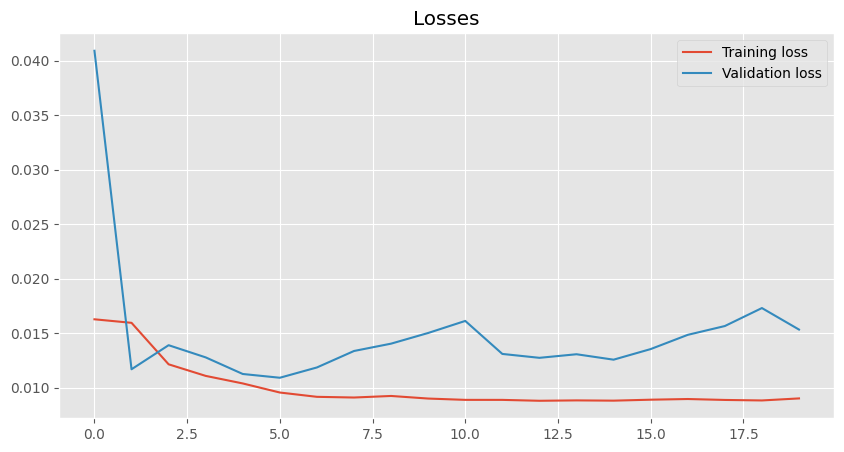

Mean Absolute Error:        4062.64013671875
Root Mean Squared Error:    5227.206711045585
R^2 Score:                  0.35106682777404785
{'mae': 4062.64013671875, 'rmse': 5227.206711045585, 'r2': 0.35106682777404785}
Mean Absolute Error:        3770.464895722883
Root Mean Squared Error:    4723.833494744284
R^2 Score:                  0.47003185507135803
{'mae': 3770.464895722883, 'rmse': 4723.833494744284, 'r2': 0.47003185507135803}


In [43]:
model_name = "rnn"
predictions, values = General_Settings(model_name)
df_result = format_predictions(
    predictions,
    values,
    X_test,
    scaler
)
print(calculate_metrics(df_result))
df_baseline = build_baseline_model(
    df_features,
    0.2,
    "load"
)
print(calculate_metrics(df_baseline))
plot_predictions(
    df_result,
    df_baseline
)

### LSTM Predictions

[1/20] Training loss: 0.0158	 Validation loss: 0.0124
[2/20] Training loss: 0.0130	 Validation loss: 0.0125
[3/20] Training loss: 0.0117	 Validation loss: 0.0146
[4/20] Training loss: 0.0106	 Validation loss: 0.0143
[5/20] Training loss: 0.0102	 Validation loss: 0.0114
[6/20] Training loss: 0.0099	 Validation loss: 0.0105
[7/20] Training loss: 0.0098	 Validation loss: 0.0105
[8/20] Training loss: 0.0096	 Validation loss: 0.0101
[9/20] Training loss: 0.0095	 Validation loss: 0.0098
[10/20] Training loss: 0.0093	 Validation loss: 0.0092


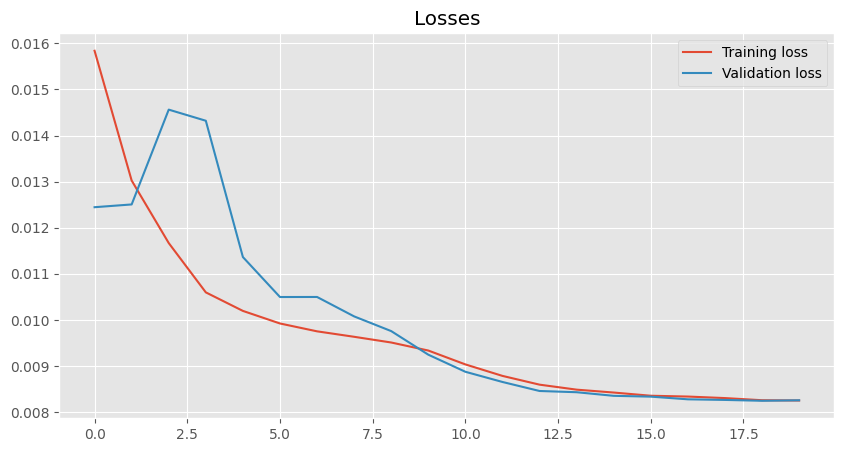

Mean Absolute Error:        3083.789306640625
Root Mean Squared Error:    4024.5101565283694
R^2 Score:                  0.6153314113616943
{'mae': 3083.789306640625, 'rmse': 4024.5101565283694, 'r2': 0.6153314113616943}
Mean Absolute Error:        3770.464895722883
Root Mean Squared Error:    4723.833494744284
R^2 Score:                  0.47003185507135803
{'mae': 3770.464895722883, 'rmse': 4723.833494744284, 'r2': 0.47003185507135803}


In [44]:
model_name = "lstm"
predictions, values = General_Settings(model_name)
df_result = format_predictions(
    predictions,
    values,
    X_test,
    scaler
)
print(calculate_metrics(df_result))
df_baseline = build_baseline_model(
    df_features,
    0.2,
    "load"
)
print(calculate_metrics(df_baseline))
plot_predictions(
    df_result,
    df_baseline
)

### GRU Predictions

[1/20] Training loss: 0.0153	 Validation loss: 0.0123
[2/20] Training loss: 0.0130	 Validation loss: 0.0132
[3/20] Training loss: 0.0119	 Validation loss: 0.0162
[4/20] Training loss: 0.0109	 Validation loss: 0.0134
[5/20] Training loss: 0.0103	 Validation loss: 0.0123
[6/20] Training loss: 0.0096	 Validation loss: 0.0108
[7/20] Training loss: 0.0089	 Validation loss: 0.0107
[8/20] Training loss: 0.0087	 Validation loss: 0.0098
[9/20] Training loss: 0.0087	 Validation loss: 0.0096
[10/20] Training loss: 0.0086	 Validation loss: 0.0092


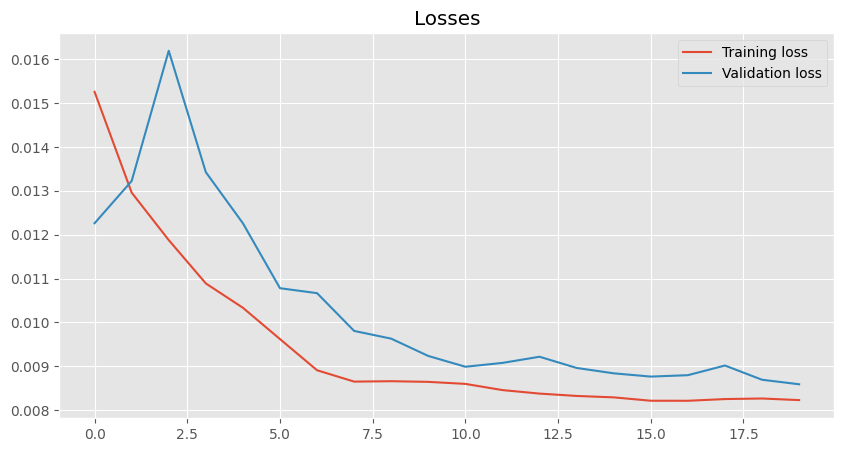

Mean Absolute Error:        3109.49609375
Root Mean Squared Error:    4095.48348794132
R^2 Score:                  0.6016443371772766
{'mae': 3109.49609375, 'rmse': 4095.48348794132, 'r2': 0.6016443371772766}
Mean Absolute Error:        3770.464895722883
Root Mean Squared Error:    4723.833494744284
R^2 Score:                  0.47003185507135803
{'mae': 3770.464895722883, 'rmse': 4723.833494744284, 'r2': 0.47003185507135803}


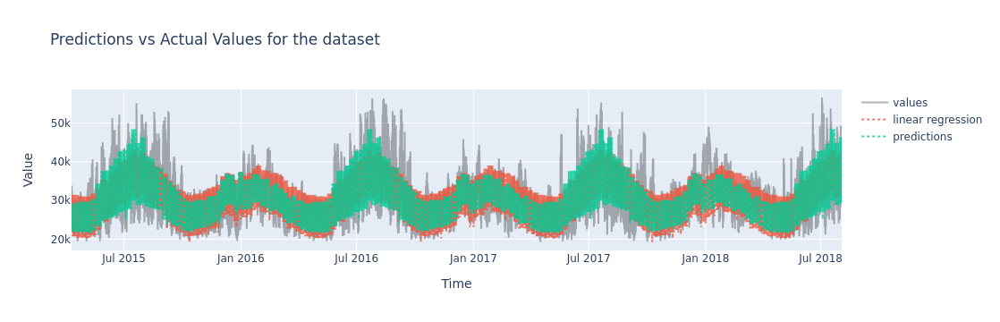

In [45]:
model_name = "gru"
predictions, values = General_Settings(model_name)
df_result = format_predictions(
    predictions,
    values,
    X_test,
    scaler
)
print(calculate_metrics(df_result))
df_baseline = build_baseline_model(
    df_features,
    0.2,
    "load"
)
print(calculate_metrics(df_baseline))
plot_predictions(
    df_result,
    df_baseline
)